# Unsupervised learning: Stock Market Clustering


## Introduction

In financial markets, investors and analysts are often faced with thousands of stocks to analyze. Identifying groups of stocks that behave similarly can simplify decision-making, improve portfolio diversification, and uncover hidden patterns. One effective unsupervised learning approach to achieve this is **clustering** — grouping stocks based on key characteristics such as return and volatility.

**Return** represents the average profitability of a stock, while **volatility** measures the degree of price fluctuation and thus the risk associated with the investment. By analyzing these two features, we can classify companies according to their risk–return profiles, revealing insights into market behavior and investment opportunities.

## Objective

The goal of this project is to:

- **Filter** and analyze daily stock data from the most recent year (2017-02-08 to 2018-02-07).
- **Engineer key features**: daily return and volatility per company.
- **Cluster companies** based on these features to discover behavioral groupings:
  - High-return vs low-return stocks
  - High-volatility vs low-volatility stocks
- **Visualize and interpret** the clusters to understand the structure and risk–return dynamics of the market.

This clustering provides a foundation for portfolio construction, risk profiling, and further financial modeling.


In [1]:
import numpy as np 
import pandas as pd
import matplotlib.pyplot as plt
import plotly.express as px
import seaborn as sns

In [2]:
# Ignore all the warnings

import warnings
warnings.filterwarnings('ignore')

In [3]:
# Load the Dataset
df = pd.read_csv("all_stocks.csv")

In [4]:
df.head(10)

,date,open,high,low,close,volume,Name
0,2013-02-08,15.07,15.12,14.63,14.75,8407500,AAL
1,2013-02-11,14.89,15.01,14.26,14.46,8882000,AAL
2,2013-02-12,14.45,14.51,14.10,14.27,8126000,AAL
3,2013-02-13,14.30,14.94,14.25,14.66,10259500,AAL
4,2013-02-14,14.94,14.96,13.16,13.99,31879900,AAL
5,2013-02-15,13.93,14.61,13.93,14.50,15628000,AAL
6,2013-02-19,14.33,14.56,14.08,14.26,11354400,AAL
7,2013-02-20,14.17,14.26,13.15,13.33,14725200,AAL
8,2013-02-21,13.62,13.95,12.90,13.37,11922100,AAL
9,2013-02-22,13.57,13.60,13.21,13.57,6071400,AAL


In [5]:
df.shape

(619040, 7)

In [6]:
# Select the range

first_day = df['date'].min()
last_day = df['date'].max()

print("First day:", first_day)
print("Last day:", last_day)

First day: 2013-02-08
Last day: 2018-02-07


In [7]:
# Filter for the last  year

start_date = "2017-02-08"
end_date = "2018-02-07"
df_filtered = df[(df['date'] >= start_date) & (df['date'] <= end_date)]

# Optional: check how many companies remain
company_counts = df_filtered['Name'].value_counts()
print(company_counts)

Name
AAL     252
NEE     252
NUE     252
NTRS    252
NTAP    252
       ... 
DXC     215
BHGE    152
BHF     143
DWDP    109
APTV     44
Name: count, Length: 505, dtype: int64


In [8]:
print("Before filtering:",df.shape)
print("After filtering:",df_filtered.shape)

Before filtering: (619040, 7)
After filtering: (126663, 7)


In [9]:
# Check for any missing values in the dataset
null_counts = df_filtered.isnull().sum()
print(null_counts)

# Show only columns with missing values
null_counts[null_counts > 0]

date      0
open      1
high      1
low       1
close     0
volume    0
Name      0
dtype: int64


open    1
high    1
low     1
dtype: int64

In [10]:
# Drop missing values
df_cleaned = df_filtered.dropna()

df_cleaned.isna().sum()

date      0
open      0
high      0
low       0
close     0
volume    0
Name      0
dtype: int64

In [11]:
# Unique companies and their values

print("unique companies", df_cleaned['Name'].nunique())

print(df_cleaned["Name"].value_counts())

unique companies 505
Name
AAL     252
NEE     252
NUE     252
NTRS    252
NTAP    252
       ... 
DXC     215
BHGE    152
BHF     142
DWDP    109
APTV     44
Name: count, Length: 505, dtype: int64


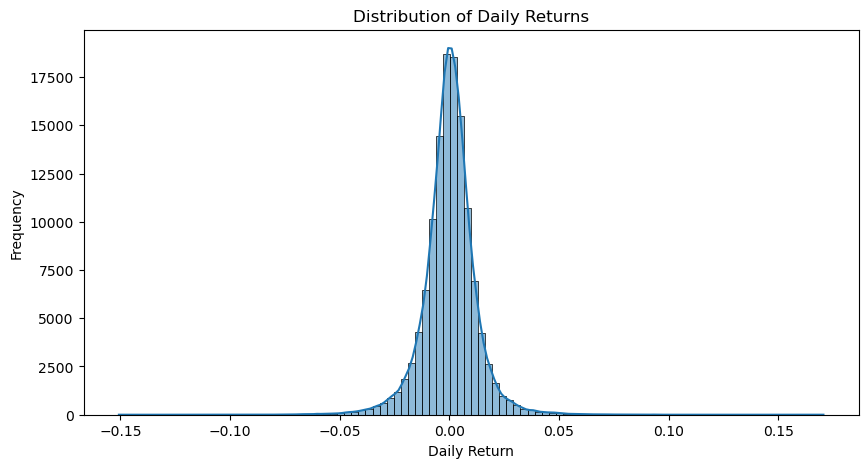

In [12]:
# Calculate daily return
df_cleaned['daily_return'] = (df_cleaned['close'] - df_cleaned['open']) / df_cleaned['open']

plt.figure(figsize=(10, 5))
sns.histplot(df_cleaned['daily_return'], bins=100, kde=True)
plt.title('Distribution of Daily Returns')
plt.xlabel('Daily Return')
plt.ylabel('Frequency')
plt.show()

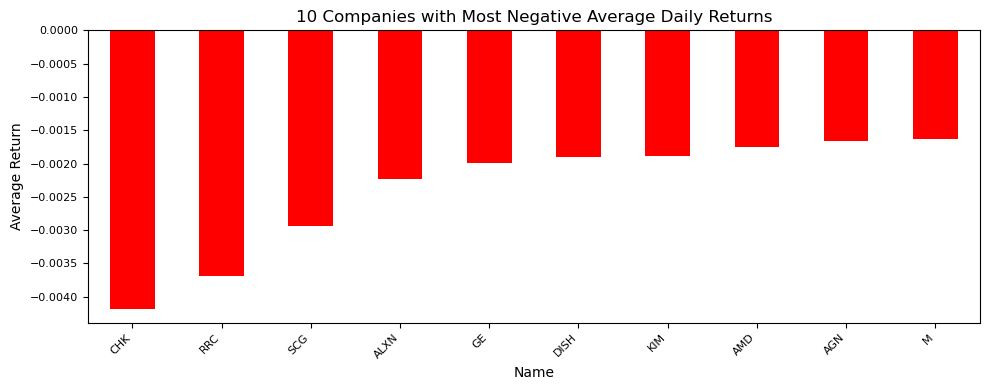

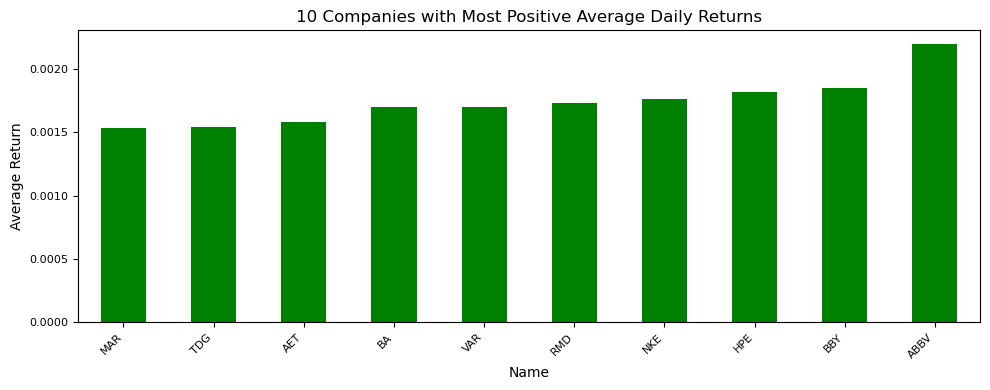

In [13]:
# Compute and sort average daily returns
avg_returns = df_cleaned.groupby('Name')['daily_return'].mean().sort_values()

# Bottom 10 (most negative)
neg_extremes = avg_returns.head(10)

# Top 10 (most positive)
pos_extremes = avg_returns.tail(10)

# Plot bottom 10 negative
plt.figure(figsize=(10, 4))
neg_extremes.plot(kind='bar', color='red', fontsize=8)
plt.title('10 Companies with Most Negative Average Daily Returns')
plt.ylabel('Average Return')
plt.xticks(rotation=45, ha='right')
plt.tight_layout()
plt.show()

# Plot top 10 positive
plt.figure(figsize=(10, 4))
pos_extremes.plot(kind='bar', color='green', fontsize=8)
plt.title('10 Companies with Most Positive Average Daily Returns')
plt.ylabel('Average Return')
plt.xticks(rotation=45, ha='right')
plt.tight_layout()
plt.show()

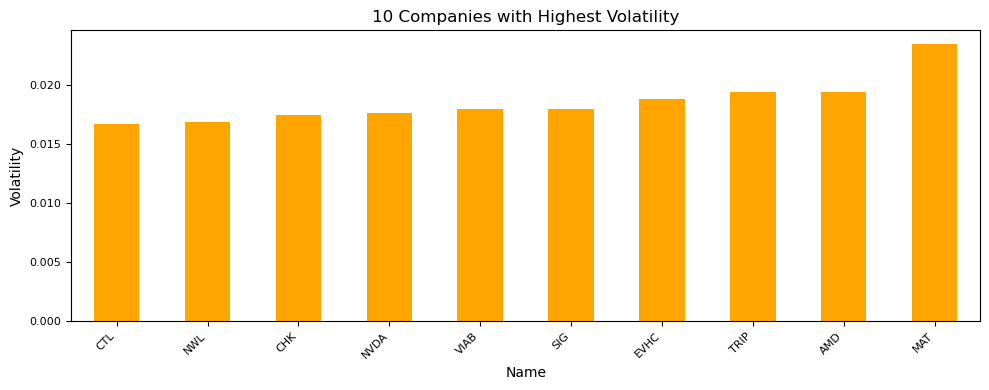

In [14]:
# Calculate volatility
df_cleaned['volatility'] = (df_cleaned['high'] - df_cleaned['low']) / df_cleaned['open']
volatility = df_cleaned.groupby('Name')['volatility'].std().sort_values()

# Top 10 (highest volatility)
high_vol = volatility.tail(10)

# Plot highest volatility
plt.figure(figsize=(10, 4))
high_vol.plot(kind='bar', color='orange', fontsize=8)
plt.title('10 Companies with Highest Volatility')
plt.ylabel('Volatility')
plt.xticks(rotation=45, ha='right')
plt.tight_layout()
plt.show()

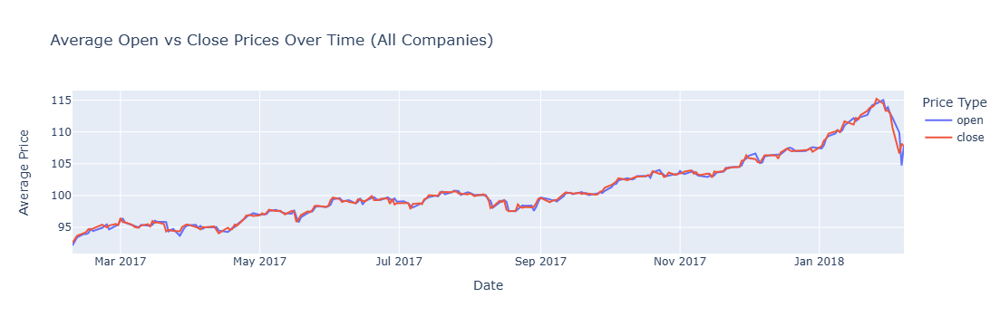

In [15]:
# Compute average open and close prices by date
avg_prices = df_cleaned.groupby('date')[['open', 'close']].mean().reset_index()

# Reshape to long format
df_avg_long = pd.melt(
    avg_prices,
    id_vars='date',
    value_vars=['open', 'close'],
    var_name='Price Type',
    value_name='Price'
)

# Plot average open vs close prices
fig = px.line(
    df_avg_long,
    x='date',
    y='Price',
    color='Price Type',
    title='Average Open vs Close Prices Over Time (All Companies)',
    labels={'date': 'Date', 'Price': 'Average Price'}
)
fig.update_layout(xaxis_title='Date', yaxis_title='Average Price', legend_title='Price Type')
fig.show()

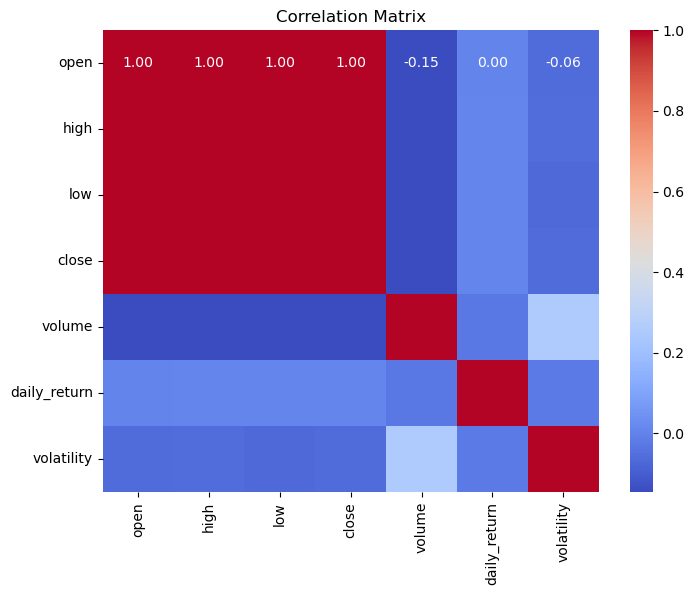

In [16]:
# Plot the correlation

features = ['open', 'high', 'low', 'close', 'volume', 'daily_return', 'volatility']
corr_matrix = df_cleaned[features].corr()

plt.figure(figsize=(8, 6))
sns.heatmap(corr_matrix, annot=True, cmap='coolwarm', fmt='.2f')
plt.title('Correlation Matrix')

plt.show()

In [17]:
corr_matrix

,open,high,low,close,volume,daily_return,volatility
open,1.000000,0.999953,0.999945,0.999904,-0.145399,0.002265,-0.062105
high,0.999953,1.000000,0.999924,0.999951,-0.145054,0.006490,-0.058593
low,0.999945,0.999924,1.000000,0.999955,-0.145874,0.006870,-0.066086
close,0.999904,0.999951,0.999955,1.000000,-0.145479,0.010776,-0.062446
volume,-0.145399,-0.145054,-0.145874,-0.145479,1.000000,-0.025640,0.252984
daily_return,0.002265,0.006490,0.006870,0.010776,-0.025640,1.000000,-0.021939
volatility,-0.062105,-0.058593,-0.066086,-0.062446,0.252984,-0.021939,1.000000


In [18]:
df_cleaned.head()

,date,open,high,low,close,volume,Name,daily_return,volatility
1007,2017-02-08,45.26,45.260,44.51,45.06,4330414,AAL,-0.004419,0.016571
1008,2017-02-09,45.07,46.599,44.94,46.30,7089902,AAL,0.027291,0.036809
1009,2017-02-10,46.62,46.700,46.17,46.45,4040567,AAL,-0.003647,0.011369
1010,2017-02-13,46.56,47.780,46.50,47.41,6158580,AAL,0.018256,0.027491
1011,2017-02-14,47.26,47.280,46.45,46.57,6271654,AAL,-0.014600,0.017562


# Method 1

In [19]:
df1 = df_cleaned.copy()
df1.head(3)

,date,open,high,low,close,volume,Name,daily_return,volatility
1007,2017-02-08,45.26,45.260,44.51,45.06,4330414,AAL,-0.004419,0.016571
1008,2017-02-09,45.07,46.599,44.94,46.30,7089902,AAL,0.027291,0.036809
1009,2017-02-10,46.62,46.700,46.17,46.45,4040567,AAL,-0.003647,0.011369


## K-means clustering

In [21]:
from sklearn.preprocessing import StandardScaler
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score

# Standardize features
scaler = StandardScaler()
scaled_df = scaler.fit_transform(df1[['daily_return', 'volatility']])

# Elbow Method
inertia = []
range_k = range(2, 10)

for k in range_k:
    kmeans = KMeans(n_clusters=k, random_state=42, n_init=10)
    kmeans.fit(scaled_df)
    inertia.append(kmeans.inertia_)

# Plot Elbow
plt.figure(figsize=(12, 5))
plt.plot(K, inertia, 'bo-')
plt.xlabel('Number of Clusters (k)')
plt.ylabel('Inertia')
plt.title('Elbow Method')
plt.grid(True)
plt.show()

NameError: name 'K' is not defined

<Figure size 1200x500 with 0 Axes>

In [ ]:
# Testing: take time

# Use sample to speed up silhouette calculation
from sklearn.utils import resample

silhouette_scores = []
K = range(2, 10)

for k in K:
    kmeans = KMeans(n_clusters=k, random_state=42, n_init=1)
    kmeans.fit(scaled_df)
    labels = kmeans.predict(scaled_df)
    silhouette_scores.append(silhouette_score(scaled_df, labels))

# Plot Silhouette Scores
plt.figure(figsize=(12, 5))
plt.plot(K, silhouette_scores, 'ro-')
plt.xlabel('Number of Clusters (k)')
plt.ylabel('Silhouette Score')
plt.title('Silhouette Method')
plt.grid(True)
plt.show()

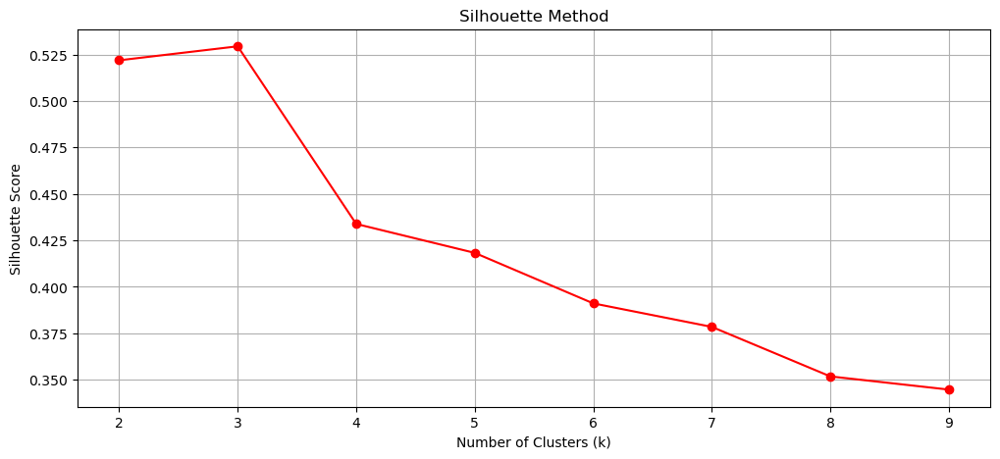

In [29]:
# Use sample to speed up silhouette calculation
from sklearn.utils import resample

sample_data = resample(scaled_df, n_samples=500, random_state=42)

silhouette_scores = []
K = range(2, 10)

for k in K:
    kmeans = KMeans(n_clusters=k, random_state=42, n_init=1)
    kmeans.fit(scaled_df)
    labels = kmeans.predict(sample_data)
    silhouette_scores.append(silhouette_score(sample_data, labels))

# Plot Silhouette Scores
plt.figure(figsize=(12, 5))
plt.plot(K, silhouette_scores, 'ro-')
plt.xlabel('Number of Clusters (k)')
plt.ylabel('Silhouette Score')
plt.title('Silhouette Method')
plt.grid(True)
plt.show()

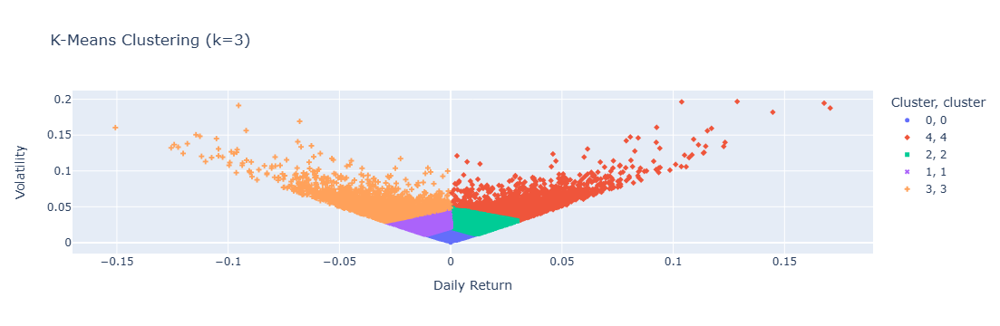

In [33]:
# Apply K-Means with the optimal k: 5
kmeans = KMeans(n_clusters=5, random_state=42)
df1['cluster'] = kmeans.fit_predict(scaled_df)

# Step 3: Plot clusters using Plotly Express
fig = px.scatter(
    df1,
    x='daily_return',
    y='volatility',
    color=df1['cluster'].astype(str),  # Convert to string for discrete color mapping
    title='K-Means Clustering (k=5)',
    labels={'daily_return': 'Daily Return', 'volatility': 'Volatility', 'color': 'Cluster'},
    symbol='cluster'
)

fig.update_traces(marker=dict(size=5))
fig.update_layout(showlegend=True)
fig.show()

## Agglomerative Clustering (Hierarchical Clustering)

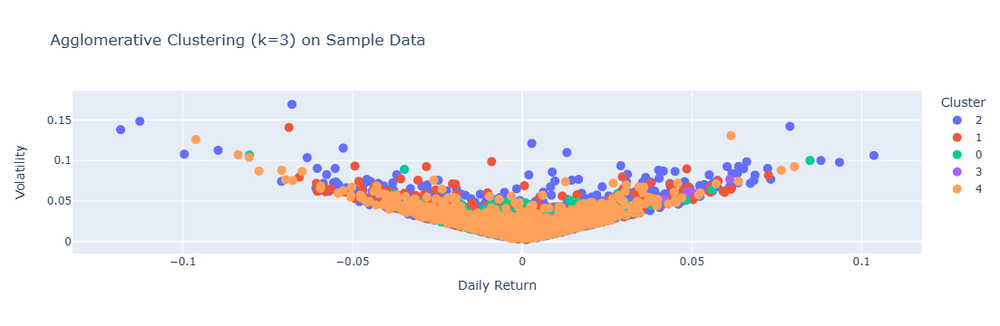

In [36]:
from sklearn.cluster import AgglomerativeClustering

# Sample from df1
df_sample = df1.sample(n=20000, random_state=42)
sample_indices = df_sample.index
sample_positions = np.where(df1.index.isin(sample_indices))[0]

#Get the corresponding scaled rows by position
scaled_sample = scaled_df[sample_positions]

# Apply Agglomerative Clustering
agglo = AgglomerativeClustering(n_clusters=5)
df_sample['cluster'] = agglo.fit_predict(scaled_sample).astype(str)

#Plot
fig = px.scatter(
    df_sample,
    x='daily_return',
    y='volatility',
    color='cluster',
    title='Agglomerative Clustering (k=5) on Sample Data',
    labels={
        'daily_return': 'Daily Return',
        'volatility': 'Volatility',
        'cluster': 'Cluster'
    }
)

fig.update_traces(marker=dict(size=10))
fig.update_layout(showlegend=True)
fig.show()

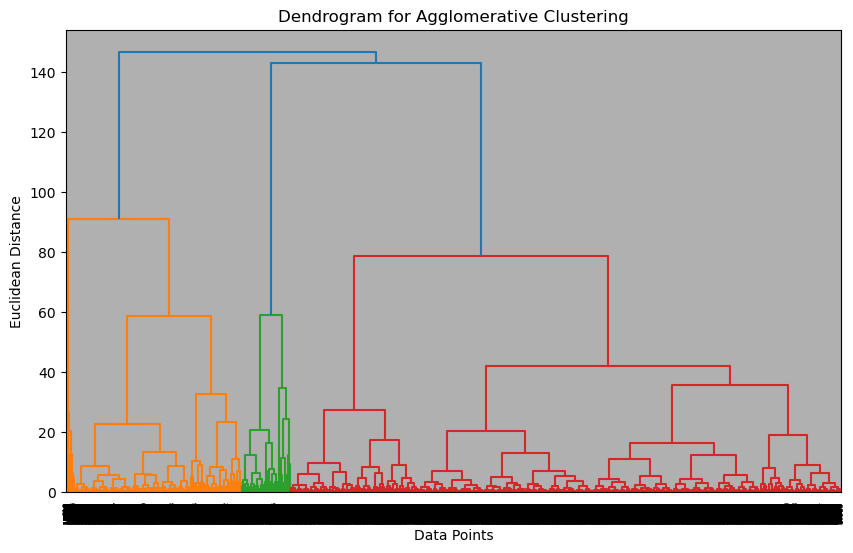

In [38]:
from scipy.cluster.hierarchy import linkage, dendrogram

# Compute linkage matrix
linked = linkage(scaled_sample, method='ward')

# Plot dendrogram
plt.figure(figsize=(10, 6))
dendrogram(linked)
plt.title('Dendrogram for Agglomerative Clustering')
plt.xlabel('Data Points')
plt.ylabel('Euclidean Distance')
plt.grid(True)
plt.show()

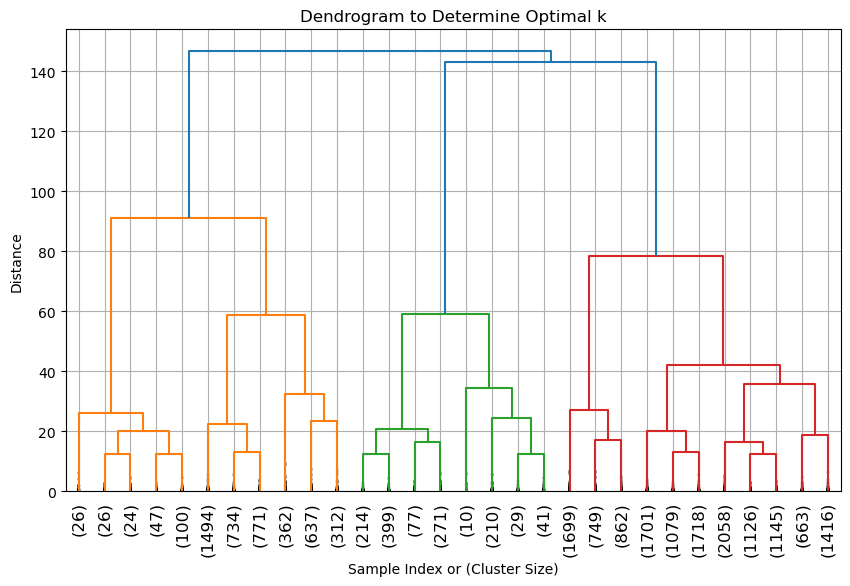

In [38]:
from scipy.cluster.hierarchy import linkage, dendrogram, fcluster
import matplotlib.pyplot as plt

# Compute linkage matrix
linked = linkage(scaled_sample, method='ward') # single, complete, 

# Plot dendrogram
plt.figure(figsize=(10, 6))

dendrogram(linked, truncate_mode='lastp', p=30, leaf_rotation=90., leaf_font_size=12., show_contracted=True)

plt.title('Dendrogram to Determine Optimal k')
plt.xlabel('Sample Index or (Cluster Size)')
plt.ylabel('Distance')
plt.grid(True)
plt.show()

In [11]:
import pandas as pd
from sklearn.preprocessing import StandardScaler
from sklearn.cluster import AgglomerativeClustering

# Sample data (replace with your real dataset)
df = pd.DataFrame({
    'daily_return': [0.01, 0.02, 0.015, -0.01, 0.005],
    'volatility': [0.03, 0.05, 0.04, 0.02, 0.025]
})

# Scale the features
scaler = StandardScaler()
scaled_data = scaler.fit_transform(df[['daily_return', 'volatility']])

# Clustering
cluster_model = AgglomerativeClustering(n_clusters=2)
clusters = cluster_model.fit_predict(scaled_data)

# Add cluster info back to a new DataFrame for plotting
scaled_sample = pd.DataFrame(scaled_data, columns=['daily_return', 'volatility'])
scaled_sample['cluster'] = clusters



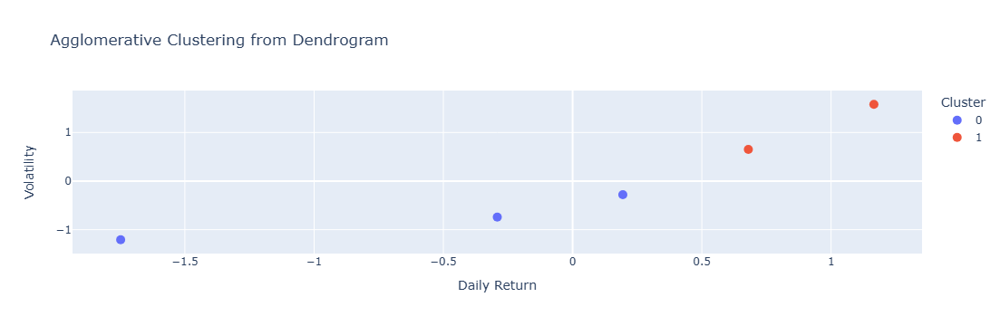

In [12]:
import plotly.express as px

# Optional: convert cluster to string
scaled_sample['cluster'] = scaled_sample['cluster'].astype(str)

fig = px.scatter(
    scaled_sample,
    x='daily_return',
    y='volatility',
    color='cluster',
    title='Agglomerative Clustering from Dendrogram',
    labels={
        'daily_return': 'Daily Return',
        'volatility': 'Volatility',
        'cluster': 'Cluster'
    }
)

fig.update_traces(marker=dict(size=10))
fig.update_layout(showlegend=True)
fig.show()


## Feature importance 


In [29]:
import numpy as np
import pandas as pd
from sklearn.datasets import make_blobs
from sklearn.preprocessing import StandardScaler
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score
from sklearn.utils import shuffle

# Create synthetic dataset
X, _ = make_blobs(n_samples=300, centers=4, n_features=5, random_state=42)
df = pd.DataFrame(X, columns=[f'Feature_{i}' for i in range(X.shape[1])])

# Standardize features
scaler = StandardScaler()
X_scaled = scaler.fit_transform(df)

# Baseline clustering
kmeans = KMeans(n_clusters=4, random_state=42)
labels = kmeans.fit_predict(X_scaled)
baseline_score = silhouette_score(X_scaled, labels)

print(f"Baseline Silhouette Score: {baseline_score:.4f}")

# --- Permutation Feature Importance ---
def permutation_importance(X, model, score_fn):
    baseline = score_fn(X, model.fit_predict(X))
    importances = []
    
    for i in range(X.shape[1]):
        X_permuted = X.copy()
        np.random.shuffle(X_permuted[:, i])
        new_score = score_fn(X_permuted, model.fit_predict(X_permuted))
        importance = baseline - new_score
        importances.append(importance)
    
    return importances

# Compute permutation importance
importances = permutation_importance(X_scaled, KMeans(n_clusters=4, random_state=42), silhouette_score)

# Display results
for i, imp in enumerate(importances):
    print(f"Feature_{i} importance (perm drop): {imp:.4f}")


Baseline Silhouette Score: 0.7252
Feature_0 importance (perm drop): 0.2062
Feature_1 importance (perm drop): 0.2326
Feature_2 importance (perm drop): 0.2435
Feature_3 importance (perm drop): 0.1930
Feature_4 importance (perm drop): 0.1834


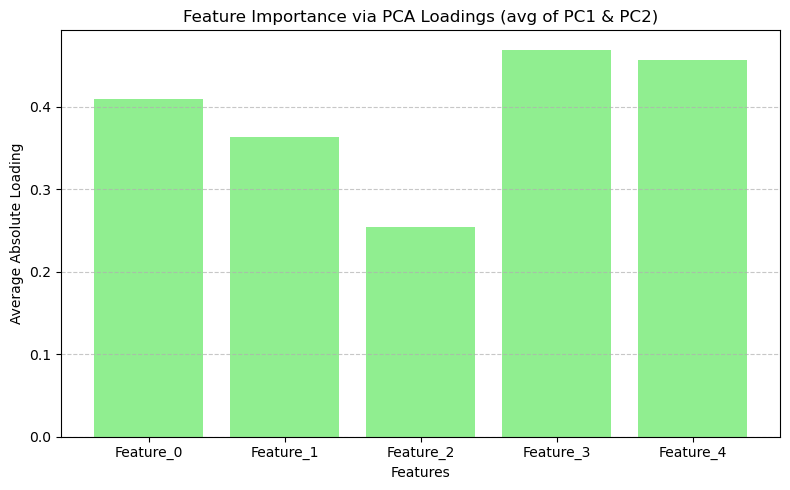

In [31]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.datasets import make_blobs
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA

# Create synthetic dataset
X, _ = make_blobs(n_samples=300, centers=4, n_features=5, random_state=42)
df = pd.DataFrame(X, columns=[f'Feature_{i}' for i in range(X.shape[1])])

# Standardize features
scaler = StandardScaler()
X_scaled = scaler.fit_transform(df)

# Apply PCA
pca = PCA(n_components=2)  # Only first 2 components for interpretability
pca.fit(X_scaled)

# Get loadings (feature contributions to PCs)
loadings = np.abs(pca.components_)  # absolute value of loadings
avg_importance = loadings.mean(axis=0)  # average across first 2 PCs

# Plotting
feature_names = df.columns
plt.figure(figsize=(8, 5))
plt.bar(feature_names, avg_importance, color='lightgreen')
plt.title('Feature Importance via PCA Loadings (avg of PC1 & PC2)')
plt.xlabel('Features')
plt.ylabel('Average Absolute Loading')
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.tight_layout()
plt.show()
